In [44]:
# Bibliotecas
import numpy as np
import pandas as pd
import scipy.stats as stats
import seaborn as sns
import matplotlib.pyplot as plt
import gdown
import sidetable
import pandas_profiling
import missingno as msno
from ipywidgets import interact, widgets
import plotly.express as px

from sklearn.preprocessing import scale, minmax_scale, power_transform
from sklearn.model_selection import train_test_split
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.metrics import r2_score

1. Leia o dataset
2. Utilize o describe para verificar a distribuição dos dados

In [45]:
# Base de dados
df = pd.read_csv(r'C:\Users\alexa\OneDrive\Área de Trabalho\desafio_5\data.csv', encoding='latin1')


In [46]:
# Análise para verificar as colunas do dataset
df.head()

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
0,536365,85123A,WHITE HANGING HEART T-LIGHT HOLDER,6,12/1/2010 8:26,2.55,17850.0,United Kingdom
1,536365,71053,WHITE METAL LANTERN,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
2,536365,84406B,CREAM CUPID HEARTS COAT HANGER,8,12/1/2010 8:26,2.75,17850.0,United Kingdom
3,536365,84029G,KNITTED UNION FLAG HOT WATER BOTTLE,6,12/1/2010 8:26,3.39,17850.0,United Kingdom
4,536365,84029E,RED WOOLLY HOTTIE WHITE HEART.,6,12/1/2010 8:26,3.39,17850.0,United Kingdom


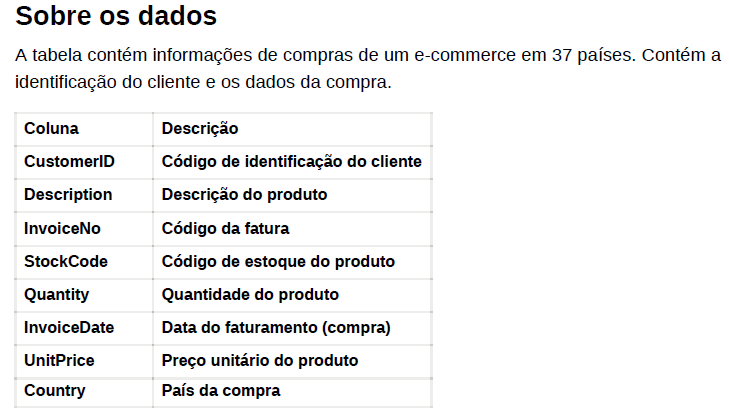

1. Leia o dataset
2. Utilize o describe para verificar a distribuição dos dados
3. Analise o tipo dos dados

In [47]:
# Verificando os quartis, desvio padrão, máximo e minímo
df.describe()

,Quantity,UnitPrice,CustomerID
count,541909.000000,541909.000000,406829.000000
mean,9.552250,4.611114,15287.690570
std,218.081158,96.759853,1713.600303
min,-80995.000000,-11062.060000,12346.000000
25%,1.000000,1.250000,13953.000000
50%,3.000000,2.080000,15152.000000
75%,10.000000,4.130000,16791.000000
max,80995.000000,38970.000000,18287.000000


In [48]:
# Análise para verificar se tem elementos nulos e quais os tipos de dados das colunas
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 541909 entries, 0 to 541908
Data columns (total 8 columns):
 #   Column       Non-Null Count   Dtype  
---  ------       --------------   -----  
 0   InvoiceNo    541909 non-null  object 
 1   StockCode    541909 non-null  object 
 2   Description  540455 non-null  object 
 3   Quantity     541909 non-null  int64  
 4   InvoiceDate  541909 non-null  object 
 5   UnitPrice    541909 non-null  float64
 6   CustomerID   406829 non-null  float64
 7   Country      541909 non-null  object 
dtypes: float64(2), int64(1), object(5)
memory usage: 33.1+ MB


1. Verifique os valores nulos com o isna e utilize a função sum para a somar a quantidade de nulos
2. Utilize a função dropna para remover os nulos

In [49]:
# Identificar e mostrar valores nulos para possíveis trativas
df_missing = (
  df.isna().sum()
  .to_frame('missing_count')
  .join((df.isna().sum() / df.shape[0]).to_frame('missing_pct'))
  .sort_values('missing_count', ascending=False)
)

df_missing.style.format('{:.2%}', subset=['missing_pct'])

,missing_count,missing_pct
CustomerID,135080,24.93%
Description,1454,0.27%
InvoiceNo,0,0.00%
StockCode,0,0.00%
Quantity,0,0.00%
InvoiceDate,0,0.00%
UnitPrice,0,0.00%
Country,0,0.00%


In [50]:
df = df.dropna(subset=['CustomerID', 'Description']).reset_index(drop=True)

In [51]:
# Verificando novamente se ainda tem valores nulos no dataset
df_missing = (
  df.isna().sum()
  .to_frame('missing_count')
  .join((df.isna().sum() / df.shape[0]).to_frame('missing_pct'))
  .sort_values('missing_count', ascending=False)
)

df_missing.style.format('{:.2%}', subset=['missing_pct'])

,missing_count,missing_pct
InvoiceNo,0,0.00%
StockCode,0,0.00%
Description,0,0.00%
Quantity,0,0.00%
InvoiceDate,0,0.00%
UnitPrice,0,0.00%
CustomerID,0,0.00%
Country,0,0.00%


Dica: Se sim, remova estas observações.
1. Realize um filtro para verificar se existem dados nulos ou menor que zero
na coluna de preços
2. Filtre o dataset apenas para conter preços acima de zero
3. Realize um filtro para verificar se existem dados nulos ou menor que zero
na coluna de quantidade
4. Filtre o dataset apenas para conter quantidade acima de zero

In [52]:
df.columns

Index(['InvoiceNo', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'UnitPrice', 'CustomerID', 'Country'],
      dtype='object')

In [53]:
df[df['UnitPrice'] <=0].head(10)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
7012,537197,22841,ROUND CAKE TIN VINTAGE GREEN,1,12/5/2010 14:02,0.0,12647.0,Germany
23071,539263,22580,ADVENT CALENDAR GINGHAM SACK,4,12/16/2010 14:36,0.0,16560.0,United Kingdom
26046,539722,22423,REGENCY CAKESTAND 3 TIER,10,12/21/2010 13:45,0.0,14911.0,EIRE
29881,540372,22090,PAPER BUNTING RETROSPOT,24,1/6/2011 16:41,0.0,13081.0,United Kingdom
29883,540372,22553,PLASTERS IN TIN SKULLS,24,1/6/2011 16:41,0.0,13081.0,United Kingdom
35460,541109,22168,ORGANISER WOOD ANTIQUE WHITE,1,1/13/2011 15:10,0.0,15107.0,United Kingdom
55279,543599,84535B,FAIRY CAKES NOTEBOOK A6 SIZE,16,2/10/2011 13:08,0.0,17560.0,United Kingdom
87903,547417,22062,CERAMIC BOWL WITH LOVE HEART DESIGN,36,3/23/2011 10:25,0.0,13239.0,United Kingdom
95201,548318,22055,MINI CAKE STAND HANGING STRAWBERY,5,3/30/2011 12:45,0.0,13113.0,United Kingdom
99945,548871,22162,HEART GARLAND RUSTIC PADDED,2,4/4/2011 14:42,0.0,14410.0,United Kingdom


In [54]:
df = df[df['UnitPrice'] > 0].reset_index(drop=True)

In [55]:
df[df['Quantity'] <=0].head(10)

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
141,C536379,D,Discount,-1,12/1/2010 9:41,27.50,14527.0,United Kingdom
154,C536383,35004C,SET OF 3 COLOURED FLYING DUCKS,-1,12/1/2010 9:49,4.65,15311.0,United Kingdom
235,C536391,22556,PLASTERS IN TIN CIRCUS PARADE,-12,12/1/2010 10:24,1.65,17548.0,United Kingdom
236,C536391,21984,PACK OF 12 PINK PAISLEY TISSUES,-24,12/1/2010 10:24,0.29,17548.0,United Kingdom
237,C536391,21983,PACK OF 12 BLUE PAISLEY TISSUES,-24,12/1/2010 10:24,0.29,17548.0,United Kingdom
238,C536391,21980,PACK OF 12 RED RETROSPOT TISSUES,-24,12/1/2010 10:24,0.29,17548.0,United Kingdom
239,C536391,21484,CHICK GREY HOT WATER BOTTLE,-12,12/1/2010 10:24,3.45,17548.0,United Kingdom
240,C536391,22557,PLASTERS IN TIN VINTAGE PAISLEY,-12,12/1/2010 10:24,1.65,17548.0,United Kingdom
241,C536391,22553,PLASTERS IN TIN SKULLS,-24,12/1/2010 10:24,1.65,17548.0,United Kingdom
938,C536506,22960,JAM MAKING SET WITH JARS,-6,12/1/2010 12:38,4.25,17897.0,United Kingdom


In [56]:
df = df[df['Quantity'] > 0].reset_index(drop=True)

Verifique se existem linhas duplicadas
Dica: Se sim, remova estas observações (pois não faz sentido uma mesma
compra para o mesmo cliente no mesmo horário, com mesmos valores etc.)
1. Verifique se tem linhas duplicadas com a função duplicated
2. Drope as linhas duplicadas

In [57]:
df[df.duplicated()]

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
508,536409,21866,UNION JACK FLAG LUGGAGE TAG,1,12/1/2010 11:45,1.25,17908.0,United Kingdom
518,536409,22866,HAND WARMER SCOTTY DOG DESIGN,1,12/1/2010 11:45,2.10,17908.0,United Kingdom
528,536409,22900,SET 2 TEA TOWELS I LOVE LONDON,1,12/1/2010 11:45,2.95,17908.0,United Kingdom
530,536409,22111,SCOTTIE DOG HOT WATER BOTTLE,1,12/1/2010 11:45,4.95,17908.0,United Kingdom
546,536412,22327,ROUND SNACK BOXES SET OF 4 SKULLS,1,12/1/2010 11:49,2.95,17920.0,United Kingdom
...,...,...,...,...,...,...,...,...
397653,581538,22068,BLACK PIRATE TREASURE CHEST,1,12/9/2011 11:34,0.39,14446.0,United Kingdom
397667,581538,23318,BOX OF 6 MINI VINTAGE CRACKERS,1,12/9/2011 11:34,2.49,14446.0,United Kingdom
397670,581538,22992,REVOLVER WOODEN RULER,1,12/9/2011 11:34,1.95,14446.0,United Kingdom
397677,581538,22694,WICKER STAR,1,12/9/2011 11:34,2.10,14446.0,United Kingdom


In [58]:
# Identificando quantos valores duplicados há em cada duplicata
(
  df
 .groupby(df.columns.tolist(), dropna=False)
 .size()
 .to_frame('n_duplicates')
 .query('n_duplicates>1')
 .sort_values('n_duplicates', ascending=False)
 .head(5)
)

n_duplicates
InvoiceNo StockCode Description                         Quantity InvoiceDate      UnitPrice CustomerID Country                     
555524    22698     PINK REGENCY TEACUP AND SAUCER      1        6/5/2011 11:37   2.95      16923.0    United Kingdom            20
          22697     GREEN REGENCY TEACUP AND SAUCER     1        6/5/2011 11:37   2.95      16923.0    United Kingdom            12
572861    22775     PURPLE DRAWERKNOB ACRYLIC EDWARDIAN 12       10/26/2011 12:46 1.25      14102.0    United Kingdom             8
541266    21755     LOVE BUILDING BLOCK WORD            1        1/16/2011 16:25  5.95      15673.0    United Kingdom             6
538514    21756     BATH BUILDING BLOCK WORD            1        12/12/2010 14:27 5.95      15044.0    United Kingdom             6

In [59]:
df = df.drop_duplicates().reset_index(drop=True)

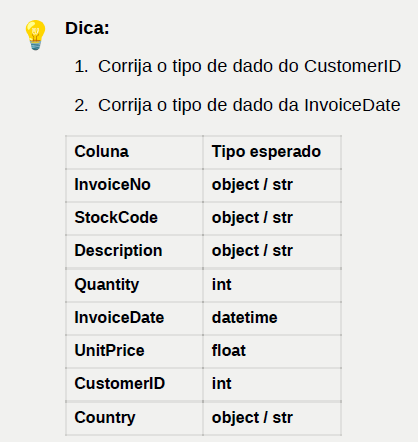

In [60]:
df['CustomerID'] = df['CustomerID'].astype(int)

In [61]:
df['InvoiceDate'] = pd.to_datetime(df['InvoiceDate'])

Dica: Vamos considerar estes valores como erro.Visualize os outliers e
remova os outliers extremos em que a quantidade do item na compra é
superior a 10.000, e o preço unitário é maior que 5.000.

In [62]:
# Criar o boxplot usando Plotly Express
fig = px.box(df, y=["Quantity", "UnitPrice"])

# Exibir a figura
fig.show()

In [63]:
df.query(" Quantity > 10000")

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
36521,541431,23166,MEDIUM CERAMIC TOP STORAGE JAR,74215,2011-01-18 10:01:00,1.04,12346,United Kingdom
392226,581483,23843,"PAPER CRAFT , LITTLE BIRDIE",80995,2011-12-09 09:15:00,2.08,16446,United Kingdom


In [64]:
df.query(" UnitPrice > 5000")

,InvoiceNo,StockCode,Description,Quantity,InvoiceDate,UnitPrice,CustomerID,Country
116868,551697,POST,POSTAGE,1,2011-05-03 13:46:00,8142.75,16029,United Kingdom


In [65]:
df = df.query(" (Quantity < 10000) or (UnitPrice < 5000)").reset_index(drop=True)

In [66]:
df.describe()

,Quantity,UnitPrice,CustomerID
count,392692.000000,392692.000000,392692.000000
mean,13.119702,3.125914,15287.843865
std,180.492832,22.241836,1713.539549
min,1.000000,0.001000,12346.000000
25%,2.000000,1.250000,13955.000000
50%,6.000000,1.950000,15150.000000
75%,12.000000,3.750000,16791.000000
max,80995.000000,8142.750000,18287.000000


Dica: Utilize as colunas Quantity e UnitPrice. Crie uma coluna adicional
com o preço total da compra

In [67]:
df['Total'] = df['Quantity']*df['UnitPrice']

Dica: Utilize a função max(). Calcule a data da última compra no dataset
como um todo, pois vamos utilizar este valor como data de comparação
para cálculo da recência.

In [68]:
ultima_compra = df['InvoiceDate'].max()

Plotando gráficos:
Top 10 países com maior valor em vendas
Top 10 produtos mais vendidos
Valor de venda total por mês
Valor de venda total por mês e por país (considere apenas os top 10)

In [69]:
px.bar(df.groupby('Country')['Total'].sum().head(10).sort_values(ascending=False))

In [70]:
px.bar(df.groupby('Description')['Quantity'].sum().head(10).sort_values(ascending=False))

In [71]:
df['Month'] = df['InvoiceDate'].dt.month

In [72]:
px.bar(df.groupby('Month')['Total'].sum().sort_values(ascending=False))

In [73]:
df.columns

Index(['InvoiceNo', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'UnitPrice', 'CustomerID', 'Country', 'Total', 'Month'],
      dtype='object')

In [74]:
idx = df.groupby('Month')['Total'].idxmax()
result_df = df.loc[idx, ['Month', 'Country', 'Total']]

In [75]:
fig = px.bar(result_df, x='Month', y='Total', color='Country', title='País com Maior Venda Total por Mês',
             labels={'Total': 'Venda Total', 'Month': 'Mês'})

fig.update_layout(xaxis_title='Mês', yaxis_title='Venda Total')

fig.show()


Cálculo do RFM
💡 Dica: Agrupe os dados por cliente e pedido/compra (InvoiceNo) e obtenha a
data e o preço total do pedido.
Com isso, agrupe novamente apenas por cliente e calcule o RFM, onde:
- R é a recência, diferença em dias da última compra do cliente e da última
compra disponível no conjunto de dados, que calcularam previamente.
- F é a frequência, ou seja, a quantidade de compras feitas pelo cliente;
- M é o ticket médio, ou seja, a média das compras feitas pelo cliente.

In [76]:
df.columns

Index(['InvoiceNo', 'StockCode', 'Description', 'Quantity', 'InvoiceDate',
       'UnitPrice', 'CustomerID', 'Country', 'Total', 'Month'],
      dtype='object')

In [77]:
df['R'] = (ultima_compra - df.groupby('CustomerID')['InvoiceDate'].transform('max').dt.normalize()).dt.days

In [81]:
df['F'] = df.groupby('CustomerID')['CustomerID'].transform('count')


In [42]:
df['M'] = df.groupby('CustomerID')['Total'].transform('mean')